# 18.065 project: comparison result

In [ ]:
import math
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import tensorflow as tf
from matplotlib import pyplot as plt
import numpy as np
import os
import sys
import sklearn
import matplotlib as mpl
from sklearn.decomposition import PCA, KernelPCA, SparsePCA, NMF
from sklearn.datasets import load_iris, make_swiss_roll
from sklearn.metrics import mean_squared_error
import math


def pca_exp(X_train, X_test, k):
    scaler = StandardScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    pca = PCA(n_components=k)
    pca.fit(X_train_scaled)
    X_test_reduced = pca.transform(X_test_scaled)
    X_test_recon = pca.inverse_transform(X_test_reduced)
    pca_err = mean_squared_error(
        X_test, scaler.inverse_transform(X_test_recon))
    print(f'\nStandard PCA err: {pca_err}\n')
    return pca.components_, pca_err


def spca_exp(X_train, X_test, k):
    scaler = StandardScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    alpha_vals = [0.001, 0.002, 0.005, 0.01, 0.02,
                  0.05, 0.10, 0.20, 0.50, 1.0, 2.0, 5.0]
    ridge_alpha = 0.0

    best_spca_alpha = 0.0
    best_spca_alpha_err = math.inf
    for idx in range(len(alpha_vals)):
        alpha = alpha_vals[idx]
        spca = SparsePCA(n_components=k, ridge_alpha=ridge_alpha, alpha=alpha)
        spca.fit(X_train_scaled)
        X_test_reduced = spca.transform(X_test_scaled)
        X_test_recon = spca.inverse_transform(X_test_reduced)

        spca_err = mean_squared_error(
            X_test, scaler.inverse_transform(X_test_recon))
        print("alpha=", alpha, "err=", spca_err)
        if spca_err < best_spca_alpha_err:
            best_spca_alpha_err = spca_err
            best_spca_alpha = alpha

    print("\n\nBest SPCA:")
    print("- alpha:", best_spca_alpha)
    print("- err:", best_spca_alpha_err)

    return best_spca_alpha, best_spca_alpha_err


def spca_exp_faces(X_train, X_test, k, h, w):
    # h is the height of each face, w is the width of each face
    scaler = StandardScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    alpha_vals = [0.001, 0.002, 0.005, 0.01, 0.02]
    ridge_alpha = 0.0

    best_spca_alpha = 0.0
    best_spca_alpha_err = math.inf
    for idx in range(len(alpha_vals)):
        alpha = alpha_vals[idx]
        spca = SparsePCA(n_components=k, ridge_alpha=ridge_alpha, alpha=alpha)
        spca.fit(X_train)
        X_test_reduced = spca.transform(X_test)
        X_test_recon = spca.inverse_transform(X_test_reduced)
        spca_err = mean_squared_error(
            X_test, scaler.inverse_transform(X_test_recon))
        print("alpha=", alpha, "err=", spca_err)
        if spca_err < best_spca_alpha_err:
            best_spca_alpha_err = spca_err
            best_spca_alpha = alpha
            best_eigenfaces_spca = spca.components_.reshape((k, h, w))

    print("\n\nBest SPCA:")
    print("- alpha:", best_spca_alpha)
    print("- err:", best_spca_alpha_err)

    return best_spca_alpha, best_spca_alpha_err, best_eigenfaces_spca


def kernel_exp(X_train, X_test, k, no_sigmoid=False):
    scaler = StandardScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # lin_pca = KernelPCA(n_components=k, kernel="linear",
    #                     fit_inverse_transform=True)
    rbf_pca = KernelPCA(n_components=k, kernel="rbf",
                        gamma=0.0433, fit_inverse_transform=True)
    sig_pca = KernelPCA(n_components=k, kernel="sigmoid",
                        gamma=0.001, coef0=1, fit_inverse_transform=True)

    if no_sigmoid:
        kernel_options = [(132, rbf_pca, "RBF kernel, $\gamma=0.04$")]
    else:
        kernel_options = ((132, rbf_pca, "RBF kernel, $\gamma=0.04$"),
                          (133, sig_pca, "Sigmoid kernel, $\gamma=10^{-3}, r=1$"))

    best_kernel = ""
    best_kernel_err = math.inf
    for subplot, pca, title in kernel_options:
        pca.fit(X_train_scaled)
        X_test_reduced = pca.transform(X_test_scaled)
        X_test_preimage = pca.inverse_transform(X_test_reduced)
        err = mean_squared_error(
            X_test, scaler.inverse_transform(X_test_preimage))
        print("Kernel PCA (", title, ") MSE reconstruction loss:", err)
        if err < best_kernel_err:
            best_kernel = title
            best_kernel_err = err
            print("- New best kernel")

    print("\n\nBest MSE reconstruction error:", best_kernel_err)
    print("- Kernel:", best_kernel)

    return best_kernel, best_kernel_err


def plot3clusters(X, title, vtitle, target_names):
    colors = ['#A43F98', '#5358E0', '#DE0202']
    s = 50
    alpha = 0.7

    plt.figure(figsize=(9, 7))
    plt.grid(True)
    for color, i, target_name in zip(colors, [0, 1, 2], target_names):
        plt.scatter(X[y == i, 0], X[y == i, 1], color=color,
                    alpha=alpha, s=s, label=target_name)

    plt.legend(loc='best', shadow=False, scatterpoints=1)
    plt.title(title, fontsize=16, fontweight='bold')

    plt.text(0.5, -0.1, 'Principal Component 1', ha='center',
             fontsize=12, fontweight='bold', transform=plt.gca().transAxes)
    plt.text(-0.1, 0.5, 'Principal Component 2', va='center', rotation='vertical',
             fontsize=12, fontweight='bold', transform=plt.gca().transAxes)

    plt.show()

# +


def autoencoder_exp(X_train, X_test, k):
    scaler = StandardScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    input_dim = X_train_scaled.shape[1]  # input shape
    output_dim = X_train_scaled.shape[1]
    encoding_dim = k  # encoding dimension - #neurons for the dense layers
    optimizer = 'adam'
    loss = 'mse'

    input_layer = tf.keras.Input(
        shape=(input_dim,), name='input')  # input layer
    encoding_layer = tf.keras.layers.Dense(
        encoding_dim, activation='relu', name='encoding')(input_layer)  # encoding layer
    decoding_layer = tf.keras.layers.Dense(
        output_dim, activation='sigmoid', name='decoding')(encoding_layer)  # decoding layer

    input_layer = tf.keras.Input(
        shape=(input_dim,), name='input')  # input layer
    encoding_layer = tf.keras.layers.Dense(
        encoding_dim, name='encoding')(input_layer)  # encoding layer
    decoding_layer = tf.keras.layers.Dense(
        output_dim, name='decoding')(encoding_layer)  # decoding layer

    autoencoder = tf.keras.Model(input_layer, decoding_layer)
    autoencoder.compile(optimizer=optimizer, loss=loss)
    autoencoder.summary()

    # Set other parameters
    epochs = 1000
    batch_size = 16
    shuffle = True
    validation_split = 0.1
    verbose = 0

    callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=100)
    history = autoencoder.fit(X_train_scaled, X_train_scaled,
                              epochs=epochs,
                              batch_size=batch_size,
                              shuffle=shuffle,
                              validation_split=validation_split,
                              verbose=verbose,
                              callbacks=[callback])

    # Plot the loss
    plt.plot(history.history['loss'], color='#FF7E79', linewidth=3, alpha=0.5)
    plt.plot(history.history['val_loss'],
             color='#007D66', linewidth=3, alpha=0.4)
    plt.title('Model train vs Validation loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='best')
    plt.grid(True)
    plt.show()

    print("Training loss:", history.history['loss'][-1])
    print("Validation loss:", history.history['val_loss'][-1])

    # Compute MSE on train and test data
    autoencoder_err_train = mean_squared_error(
        X_train, scaler.inverse_transform(autoencoder(X_train_scaled)))

    autoencoder_err_test = mean_squared_error(
        X_test, scaler.inverse_transform(autoencoder(X_test_scaled)))
    print("MSE on training data:", autoencoder_err_train)
    print("MSE on test data:", autoencoder_err_test)

    return autoencoder_err_train, autoencoder_err_test


def nmf_exp(X_train, X_test, k):
    print("\n\nBest NMF:")

    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    # clip scaled test data on the low end
    X_test_scaled[X_test_scaled < 0] = 0

    # Perform NMF
    model = NMF(n_components=k, init='random', random_state=109)
    W_train = model.fit_transform(X_train_scaled)
    H_train = model.components_

    # Print the basis vectors and the coefficients
    print("Basis vectors:\n", H_train)
    print("Coefficients:\n", W_train)

    # Reconstruct train data and compute MSE
    X_train_reconstructed = np.dot(W_train, H_train)

    train_mse = mean_squared_error(
        X_train, scaler.inverse_transform(X_train_reconstructed))

    print('\n\nBest MSE reconstruction error on train data:', train_mse)

    # Reconstruct test data and compute MSE
    W_test = model.transform(X_test_scaled)
    H_test = model.components_
    X_test_reconstructed = np.dot(W_test, H_test)

    test_mse = mean_squared_error(
        X_test, scaler.inverse_transform(X_test_reconstructed))

    print('Best MSE reconstruction error on test data:', test_mse)

    return train_mse, test_mse


def nmf_exp_faces(X_train, X_test, k, h, w):
    print("\n\nBest NMF:")

    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    # clip scaled test data on the low end
    X_test_scaled[X_test_scaled < 0] = 0

    # Perform NMF
    model = NMF(n_components=k, init='random', random_state=109)
    W_train = model.fit_transform(X_train_scaled)
    H_train = model.components_
    eigenfaces_nmf = model.components_.reshape((k, h, w))

    # Print the basis vectors and the coefficients
    print("Basis vectors:\n", H_train)
    print("Coefficients:\n", W_train)

    # Reconstruct train data and compute MSE
    X_train_reconstructed = np.dot(W_train, H_train)
    train_mse = mean_squared_error(
        X_train, scaler.inverse_transform(X_train_reconstructed))
    print('\n\nBest MSE reconstruction error on train data:', train_mse)

    # Reconstruct test data and compute MSE
    W_test = model.transform(X_test_scaled)
    H_test = model.components_
    X_test_reconstructed = np.dot(W_test, H_test)
    test_mse = mean_squared_error(
        X_test, scaler.inverse_transform(X_test_reconstructed))
    print('Best MSE reconstruction error on test data:', test_mse)

    return train_mse, test_mse, eigenfaces_nmf


def plot_gallery(images, titles, k, h, w):
    """Helper function to plot a gallery of portraits"""
    n_col = 5
    if k <= n_col:
        n_row = 1
    else:
        n_row = k // 5 + 1
    plt.figure(figsize=(1.8 * n_col, 2.4 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(n_row * n_col):
        if i == k:
            break
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())


In [ ]:
import numpy as np
import scipy
from scipy import linalg
from sklearn.metrics import mean_squared_error
from sklearn.utils.extmath import svd_flip
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Get the square of l2 norm


def l2(X, Y):
    l2_arr = np.empty([X.shape[0], Y.shape[0]])
    for i in range(X.shape[0]):
        for j in range(Y.shape[0]):
            diff = X[i, :]-Y[j, :]
            l2_arr[i, j] = np.dot(diff, diff)
    return l2_arr

# Get rbf kernel


def rbf_kernel(X, Y=None, gamma=None):
    '''
    Compute the rbf (gaussian) kernel between X and Y.

        K(x, y) = exp(-gamma ||x-y||^2)

    for each pair of rows x in X and y in Y.
    '''
    if Y is None:
        Y = X
    K = np.exp(-1*gamma*l2(X, Y))
    return K


def poly_kernel(X, Y=None, degree=3, gamma=1, coef0=0):
    '''
    Compute the polynomial kernel between X and Y.

    K(X, Y) = (gamma <X, Y> + coef0)^{degree}
    '''
    if Y is None:
        Y = X
    K = np.dot(X, Y.T, dense_output=True)
    K *= gamma
    K += coef0
    K **= degree
    return K

# Center the kernel matrix


def center_kernel(K):
    n_samples = K.shape[0]
    K_fit_rows = np.sum(K, axis=0) / n_samples
    K_fit_all = K_fit_rows.sum() / n_samples
    K_pred_cols = (np.sum(K, axis=1) / K_fit_rows.shape[0])[:, np.newaxis]
    K -= K_fit_rows
    K -= K_pred_cols
    K += K_fit_all
    return K, K_fit_rows, K_fit_all

# switch the mode to either 'transform' or 'recon'


def kernel_PCA(X_train, X_test, n_components=None, kernel='rbf', gamma=None, mode='recon', alpha=1, degree=3, scaled=True):
    if scaled:
        scaler = StandardScaler()
        scaler.fit(X_train)
        X_train_scaled = scaler.transform(X_train)
        X_test_scaled = scaler.transform(X_test)
    else:
        X_train_scaled = X_train
        X_test_scaled = X_test

    if kernel == 'rbf':
        K = rbf_kernel(X_train_scaled, gamma=gamma)
    elif kernel == 'poly':
        K = poly_kernel(X_train_scaled, degree=degree)
    K, K_fit_rows, K_fit_all = center_kernel(K)

    if n_components is None:
        n_components = K.shape[0]
    else:
        n_components = min(K.shape[0], n_components)

    # Solve for eigenvalues and eigenvectors, subset_by_index specifies the indices of smallest/largest to return
    eigenvalues, eigenvectors = scipy.linalg.eigh(
        K, subset_by_index=(K.shape[0] - n_components, K.shape[0]-1))

    # flip eigenvectors' sign to enforce deterministic output
    eigenvectors, _ = svd_flip(eigenvectors, np.zeros_like(eigenvectors).T)

    # Get indices of eigenvalues from largest to smallest
    indices = eigenvalues.argsort()[::-1]
    eigenvalues = eigenvalues[indices]
    eigenvectors = eigenvectors[:, indices]
    eigenvectors = eigenvectors[:, eigenvalues > 0]
    eigenvalues = eigenvalues[eigenvalues > 0]
    # You are supposed to find eigenvectors of K and then multiply them by K, multiplying a matrix and its eigenvector results in the same eigenvector scaled by the eigenvalue (by definition).
    X_transformed = eigenvectors * np.sqrt(eigenvalues)

    K = rbf_kernel(X_test_scaled, X_train_scaled, gamma)
    # Compute centered gram matrix between X_test and training data X_train
    K_pred_cols = (np.sum(K, axis=1) / K_fit_rows.shape[0])[:, np.newaxis]
    K -= K_fit_rows
    K -= K_pred_cols
    K += K_fit_all

    # scale eigenvectors (properly account for null-space for dot product)
    non_zeros = np.flatnonzero(eigenvalues)
    scaled_alphas = np.zeros_like(eigenvectors)
    scaled_alphas[:, non_zeros] = eigenvectors[:,
                                               non_zeros] / np.sqrt(eigenvalues[non_zeros])
    # Project with a scalar product between K and the scaled eigenvectors
    X_test_transformed = np.dot(K, scaled_alphas)
    if mode == 'transform':
        return X_test_transformed, eigenvectors, eigenvalues

    elif mode == 'recon':
        n_samples = X_transformed.shape[0]
        if kernel == 'rbf':
            K = rbf_kernel(X_transformed, gamma=gamma)
        elif kernel == 'poly':
            K = poly_kernel(X_transformed, degree=degree)
        K.flat[:: n_samples + 1] += alpha
        dual_coef = linalg.solve(
            K, X_train_scaled, assume_a="pos", overwrite_a=True)
        if kernel == 'rbf':
            K = rbf_kernel(X_test_transformed, X_transformed, gamma=gamma)
        elif kernel == 'poly':
            K = poly_kernel(X_test_transformed, X_transformed, degree=degree)
        X_test_recon = np.dot(K, dual_coef)
        if scaled:
            X_test_recon = scaler.inverse_transform(X_test_recon)
        err = mean_squared_error(X_test, X_test_recon)
        print('\n\nOwn rbf kpca implementation')
        print(f'{kernel} kernel, mse err = {err}')
        return X_test_recon, err


In [ ]:
import sklearn
import numpy as np
from sklearn.datasets import load_iris,make_swiss_roll,fetch_lfw_people
from  sklearn.model_selection import train_test_split
# Custom train/test wrappers for sklearn models
import pickle
import matplotlib.pyplot as plt

## Test sweep code

In [ ]:
def run_test_sweep(num_dataset_dims, X_train, X_test, is_faces, dataset_name, fn_prefix="results_", h=None, w=None, skip_spca_for_faces=False, no_sigmoid=False, show_eigen_faces=False):
    
    # h and w must be specified if this is a faces dataset
    assert(not (is_faces and (h is None or w is None)))        
    
    res={}
    k_iters=[]
    model_iters=[]
    data_iters=[]
    hparam_iters=[]
    loss_iters=[]
    
    k_vals=[]
    
    if num_dataset_dims<10:
        k_vals=range(1,num_dataset_dims+1)
    else:
        #k_vals=[1,2,3,4,5,6,7,8]
        # k_vals=np.linspace(start=1, stop=num_dataset_dims, num=8)
        k_vals=[1, 200, 400, 600, 800]
    
    for k_prim in k_vals:
        k=int(k_prim)
        print("Number of components: k =",k)

        # Standard PCA
        _, pca_err = pca_exp(X_train, X_test, k)
        k_iters.append(k)
        model_iters.append("pca")
        data_iters.append(dataset_name)
        hparam_iters.append({"pca":None})
        loss_iters.append(pca_err)
        
        # SPCA
        best_spca_alpha=[]
        best_spca_alpha_err=[]
        if is_faces:
            if skip_spca_for_faces:
                best_spca_alpha=None
                best_spca_alpha_err=0.0
            else:
                best_spca_alpha, best_spca_alpha_err, best_eigenfaces_spca = spca_exp_faces(X_train,X_test,k,h,w)                
        else:
            best_spca_alpha, best_spca_alpha_err = spca_exp(X_train,X_test,k)
        k_iters.append(k)
        model_iters.append("spca")
        data_iters.append(dataset_name)
        hparam_iters.append({"alpha":best_spca_alpha})
        loss_iters.append(best_spca_alpha_err)
        
        # KPCA
        best_kernel, best_kernel_err = kernel_exp(X_train,X_test,k,no_sigmoid=no_sigmoid)
        k_iters.append(k)
        model_iters.append("kpca")
        data_iters.append(dataset_name)
        hparam_iters.append({"kernel":best_kernel})
        loss_iters.append(best_kernel_err)

        # Own KPCA implementation     
        _, own_kernel_err = kernel_PCA(X_train, X_test, n_components=k, kernel='rbf', gamma=0.0433, mode='recon', alpha=1.0)
        k_iters.append(k)
        model_iters.append("own kpca")
        data_iters.append(dataset_name)
        hparam_iters.append({"kernel":'rbf'})
        loss_iters.append(own_kernel_err) 
        
        # Autoencoder
        _, best_autoencoder_err = autoencoder_exp(X_train, X_test, k)
        k_iters.append(k)
        model_iters.append("autoencoder")
        data_iters.append(dataset_name)
        hparam_iters.append({})
        loss_iters.append(best_autoencoder_err)                
        
        # NMF
        best_nmf_err=[]
        if is_faces:
            _, best_nmf_err, eigenfaces_nmf = nmf_exp_faces(X_train,X_test,k,h,w)
        else:
            _, best_nmf_err = nmf_exp(X_train,X_test,k)
        k_iters.append(k)
        model_iters.append("nmf")
        data_iters.append(dataset_name)
        hparam_iters.append({})
        loss_iters.append(best_nmf_err)              
        
        # ==> Summary
        print("- MSE loss summary: ",dataset_name,"is_faces =",is_faces,"k =",k)
        print("-- Standard PCA: err=",pca_err)
        print("-- Sparse PCA (alpha=",best_spca_alpha,"): err=",best_spca_alpha_err)
        print("-- Kernel PCA(",best_kernel,"): err=",best_kernel_err)
        print("-- Own Kernel PCA: err=",own_kernel_err)
        print("-- Autoencoder: err=",best_autoencoder_err)
        print("-- NMF: err=",best_nmf_err)

        if is_faces:
            if show_eigen_faces:
                if not skip_spca_for_faces:
                    eigenface_titles_spca = [f"SPCA eigenface {i}" for i in range(best_eigenfaces_spca.shape[0])]
                    plot_gallery(best_eigenfaces_spca, eigenface_titles_spca, k, h, w)
                    plt.show()
                eigenface_titles_nmf = [f"NMF eigenface {i}" for i in range(eigenfaces_nmf.shape[0])]
                plot_gallery(eigenfaces_nmf, eigenface_titles_nmf, k, h, w)
                plt.show()
        
        
    res["k_iters"]=k_iters
    res["model_iters"]=model_iters
    res["data_iters"]=data_iters
    res["hparam_iters"]=hparam_iters
    res["loss_iters"]=loss_iters
    
    fn=fn_prefix+dataset_name+".p"
    print("\n\nSaving results to",fn,"...")    
    with open(fn,"wb") as fp:
        pickle.dump(res, fp)
    print("- Done.")
    
    return res

In [ ]:
def res_query(res,model=None):
    k_iters=[]
    loss_iters=[]
    
    for idx in range(len(res["k_iters"])):
        if res["model_iters"][idx]==model:
            k_iters.append(res["k_iters"][idx])
            loss_iters.append(res["loss_iters"][idx])
    
    return k_iters,loss_iters

## LFW dataset: Sparse PCA, Kernel PCA, autoencoder

In [ ]:
# Takes 6 minutes to load the data if this is your first time
num_dataset_dims=2914
dataset_name='lfw'
lfw_people = fetch_lfw_people(min_faces_per_person=100)
n_samples, h, w = lfw_people.images.shape
X = lfw_people.data
n_features = X.shape[1]
y = lfw_people.target
target_names = lfw_people.target_names
n_classes = target_names.shape[0]
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=0)
#k=2 # no. of components

Number of components: k = 1

Standard PCA err: 0.0180218443274498

Kernel PCA ( RBF kernel, $\gamma=0.04$ ) MSE reconstruction loss: 0.022160564
- New best kernel


Best MSE reconstruction error: 0.022160564
- Kernel: RBF kernel, $\gamma=0.04$


Own rbf kpca implementation
rbf kernel, mse err = 0.022160562409945864
Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 2914)]            0         
                                                                 
 encoding (Dense)            (None, 1)                 2915      
                                                                 
 decoding (Dense)            (None, 2914)              5828      
                                                                 
Total params: 8,743
Trainable params: 8,743
Non-trainable params: 0
_________________________________________________________________


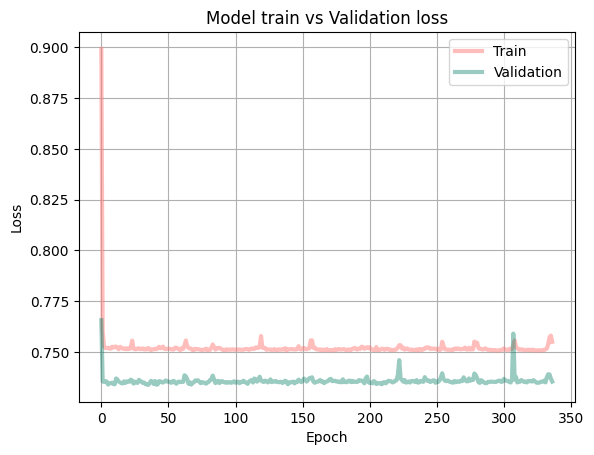

Training loss: 0.7550565600395203
Validation loss: 0.7354700565338135
MSE on training data: 0.017940048990457935
MSE on test data: 0.018050865614319813


Best NMF:
Basis vectors:
 [[0.66167533 0.6542334  0.6962716  ... 0.80206794 0.74983674 0.6949161 ]]
Coefficients:
 [[0.61603975]
 [0.60296965]
 [0.62741774]
 [0.41784835]
 [0.63245595]
 [0.5024127 ]
 [0.44127557]
 [0.71310097]
 [0.5404639 ]
 [0.4372887 ]
 [0.7366434 ]
 [0.6412019 ]
 [0.44540396]
 [0.513867  ]
 [0.64517653]
 [0.49762273]
 [0.5047831 ]
 [0.66373074]
 [0.7459561 ]
 [0.49653646]
 [0.6073801 ]
 [0.5166334 ]
 [0.3290576 ]
 [0.5126163 ]
 [0.60504526]
 [0.5740778 ]
 [0.51355124]
 [0.6369202 ]
 [0.643286  ]
 [0.5839152 ]
 [0.59254324]
 [0.5884938 ]
 [0.70601493]
 [0.6192933 ]
 [0.6137103 ]
 [0.47386503]
 [0.59911776]
 [0.48301473]
 [0.51803607]
 [0.49036303]
 [0.691416  ]
 [0.67176855]
 [0.6744445 ]
 [0.52164406]
 [0.54886806]
 [0.6772484 ]
 [0.64214635]
 [0.54671675]
 [0.5557045 ]
 [0.79866356]
 [0.5478361 ]
 [0.39243913]
 [0

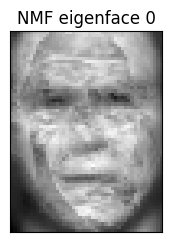

Number of components: k = 200

Standard PCA err: 0.0018263061065226793

Kernel PCA ( RBF kernel, $\gamma=0.04$ ) MSE reconstruction loss: 0.02216028
- New best kernel


Best MSE reconstruction error: 0.02216028
- Kernel: RBF kernel, $\gamma=0.04$


Own rbf kpca implementation
rbf kernel, mse err = 0.02216064996422305
Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 2914)]            0         
                                                                 
 encoding (Dense)            (None, 200)               583000    
                                                                 
 decoding (Dense)            (None, 2914)              585714    
                                                                 
Total params: 1,168,714
Trainable params: 1,168,714
Non-trainable params: 0
____________________________________________________________

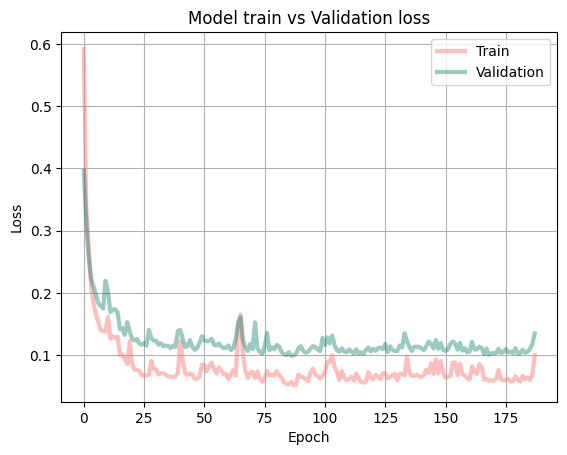

Training loss: 0.09973862767219543
Validation loss: 0.13478194177150726
MSE on training data: 0.0020865679629452896
MSE on test data: 0.003013527685737833


Best NMF:


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Basis vectors:
 [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.08266282 0.05047645 0.         ... 0.         0.00108443 0.        ]
 [0.02557514 0.         0.         ... 0.         0.         0.        ]]
Coefficients:
 [[0.         0.         0.         ... 0.03504255 0.08514338 0.        ]
 [1.9374238  0.         0.         ... 0.01603088 0.08320351 0.00352842]
 [0.8692904  0.28990832 0.4039416  ... 0.10641265 0.05595204 0.03886809]
 ...
 [0.5318321  0.         0.         ... 0.08727393 0.10868895 0.05966225]
 [1.4861786  2.110245   0.74603003 ... 0.11177389 0.13908018 0.05556824]
 [0.         0.         0.2516623  ... 0.0681035  0.1151514  0.05561418]]


Best MSE reconstruction error on train data: 0.0014743566


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Best MSE reconstruction error on test data: 0.0021814783
- MSE loss summary:  lfw is_faces = True k = 200
-- Standard PCA: err= 0.0018263061
-- Sparse PCA (alpha= None ): err= 0.0
-- Kernel PCA( RBF kernel, $\gamma=0.04$ ): err= 0.02216028
-- Own Kernel PCA: err= 0.02216064996422305
-- Autoencoder: err= 0.003013527685737833
-- NMF: err= 0.0021814783


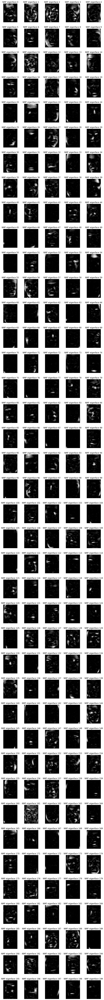

Number of components: k = 400

Standard PCA err: 0.0010170105379074812

Kernel PCA ( RBF kernel, $\gamma=0.04$ ) MSE reconstruction loss: 0.022160469
- New best kernel


Best MSE reconstruction error: 0.022160469
- Kernel: RBF kernel, $\gamma=0.04$


Own rbf kpca implementation
rbf kernel, mse err = 0.022160423496284134
Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 2914)]            0         
                                                                 
 encoding (Dense)            (None, 400)               1166000   
                                                                 
 decoding (Dense)            (None, 2914)              1168514   
                                                                 
Total params: 2,334,514
Trainable params: 2,334,514
Non-trainable params: 0
_________________________________________________________

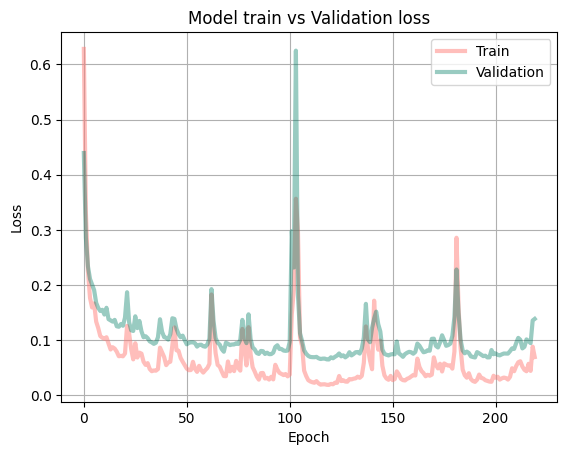

Training loss: 0.06947905570268631
Validation loss: 0.13869331777095795
MSE on training data: 0.0023311024168259867
MSE on test data: 0.003126614049190747


Best NMF:


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Basis vectors:
 [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.00168038 0.00070818 0.         ... 0.         0.         0.        ]
 [0.         0.00116375 0.00739699 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.00737918 ... 0.         0.0102725  0.        ]
 [0.         0.00862428 0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
Coefficients:
 [[1.76382411e+00 0.00000000e+00 3.19116092e+00 ... 0.00000000e+00
  0.00000000e+00 3.38056451e-03]
 [8.88282359e-01 3.86830233e-03 0.00000000e+00 ... 0.00000000e+00
  1.91077255e-02 5.64889945e-02]
 [8.54727924e-01 0.00000000e+00 6.90933764e-01 ... 2.86143348e-02
  1.04709655e-01 3.90795432e-02]
 ...
 [1.20469069e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  1.33576348e-01 0.00000000e+00]
 [4.67301512e+00 1.80547678e+00 8.16266477e-01 ... 0.00000000e+00
  7.37142637e-02 7.12966919e-02]
 [0.00000000e+00 0.000000

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Best MSE reconstruction error on test data: 0.001556743
- MSE loss summary:  lfw is_faces = True k = 400
-- Standard PCA: err= 0.0010170105
-- Sparse PCA (alpha= None ): err= 0.0
-- Kernel PCA( RBF kernel, $\gamma=0.04$ ): err= 0.022160469
-- Own Kernel PCA: err= 0.022160423496284134
-- Autoencoder: err= 0.003126614049190747
-- NMF: err= 0.001556743


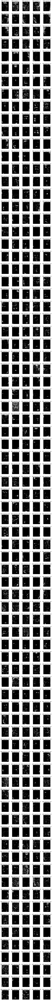

Number of components: k = 600

Standard PCA err: 0.0006906300550326705

Kernel PCA ( RBF kernel, $\gamma=0.04$ ) MSE reconstruction loss: 0.022160234
- New best kernel


Best MSE reconstruction error: 0.022160234
- Kernel: RBF kernel, $\gamma=0.04$


Own rbf kpca implementation
rbf kernel, mse err = 0.022160158873626382
Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 2914)]            0         
                                                                 
 encoding (Dense)            (None, 600)               1749000   
                                                                 
 decoding (Dense)            (None, 2914)              1751314   
                                                                 
Total params: 3,500,314
Trainable params: 3,500,314
Non-trainable params: 0
_________________________________________________________

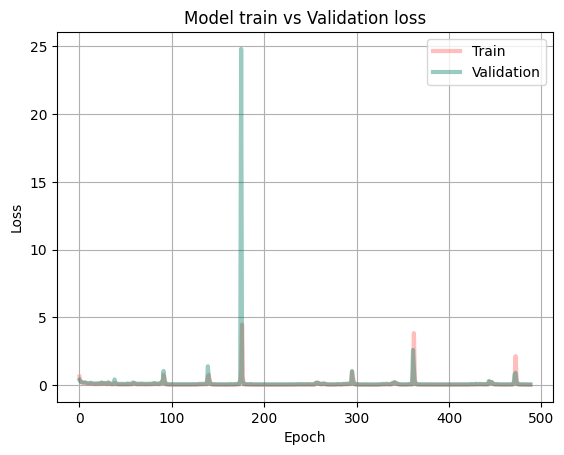

Training loss: 0.007899320684373379
Validation loss: 0.0499383807182312
MSE on training data: 0.00026072408570832037
MSE on test data: 0.0010616959904144274


Best NMF:


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Basis vectors:
 [[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [7.2987401e-05 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [4.0297811e-03 7.8015606e-04 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 6.1339545e-03 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [7.7741750e-02 6.1075382e-02 1.1208163e-02 ... 1.8253839e-03
  0.0000000e+00 7.2279028e-03]]
Coefficients:
 [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.11278603 0.         0.55128026 ... 0.         0.         0.        ]
 ...
 [0.09593243 0.         0.         ... 0.         0.03073757 0.04966477]
 [1.4672772  0.8785066  0.         ... 0.         0.         0.        ]
 [0.         0.         0.         

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Best MSE reconstruction error on test data: 0.0013369533
- MSE loss summary:  lfw is_faces = True k = 600
-- Standard PCA: err= 0.00069063006
-- Sparse PCA (alpha= None ): err= 0.0
-- Kernel PCA( RBF kernel, $\gamma=0.04$ ): err= 0.022160234
-- Own Kernel PCA: err= 0.022160158873626382
-- Autoencoder: err= 0.0010616959904144274
-- NMF: err= 0.0013369533


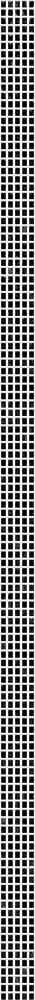

Number of components: k = 800

Standard PCA err: 0.0005190004012547433

Kernel PCA ( RBF kernel, $\gamma=0.04$ ) MSE reconstruction loss: 0.022160286
- New best kernel


Best MSE reconstruction error: 0.022160286
- Kernel: RBF kernel, $\gamma=0.04$


Own rbf kpca implementation
rbf kernel, mse err = 0.02216020712414645
Model: "model_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 2914)]            0         
                                                                 
 encoding (Dense)            (None, 800)               2332000   
                                                                 
 decoding (Dense)            (None, 2914)              2334114   
                                                                 
Total params: 4,666,114
Trainable params: 4,666,114
Non-trainable params: 0
_________________________________________________________

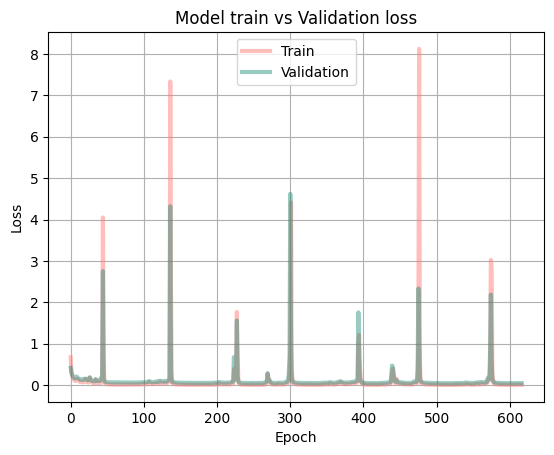

Training loss: 0.007845771498978138
Validation loss: 0.047217439860105515
MSE on training data: 0.0002570841474034136
MSE on test data: 0.0009888225001124832


Best NMF:


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Basis vectors:
 [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.0003394  0.         0.         ... 0.         0.         0.        ]
 [0.00216475 0.00027576 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.02797913 0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.0363604  0.         0.        ]]
Coefficients:
 [[0.         0.         0.         ... 0.17431836 0.         0.        ]
 [2.001376   0.40209976 0.         ... 0.         0.         0.02372363]
 [1.7343794  0.5319058  0.         ... 0.         0.00526291 0.        ]
 ...
 [0.         0.         0.         ... 0.         0.02753653 0.        ]
 [0.5553253  0.         0.         ... 0.         0.         0.03697157]
 [0.         0.         0.         ... 0.08277919 0.00330989 0.        ]]


Best MSE reconstruction error on train data: 0.00018881189


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Best MSE reconstruction error on test data: 0.0012103337
- MSE loss summary:  lfw is_faces = True k = 800
-- Standard PCA: err= 0.0005190004
-- Sparse PCA (alpha= None ): err= 0.0
-- Kernel PCA( RBF kernel, $\gamma=0.04$ ): err= 0.022160286
-- Own Kernel PCA: err= 0.02216020712414645
-- Autoencoder: err= 0.0009888225001124832
-- NMF: err= 0.0012103337


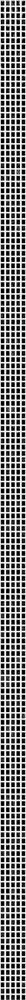



Saving results to results_lfw.p ...
- Done.


In [ ]:
# Run LFW test sweep, TODO: DON'T SKIP SPCA!
res=run_test_sweep(num_dataset_dims, X_train, X_test, is_faces=True, dataset_name=dataset_name, h=h, w=w, skip_spca_for_faces=True, no_sigmoid=True, show_eigen_faces=True)

Filename: results_lfw.p


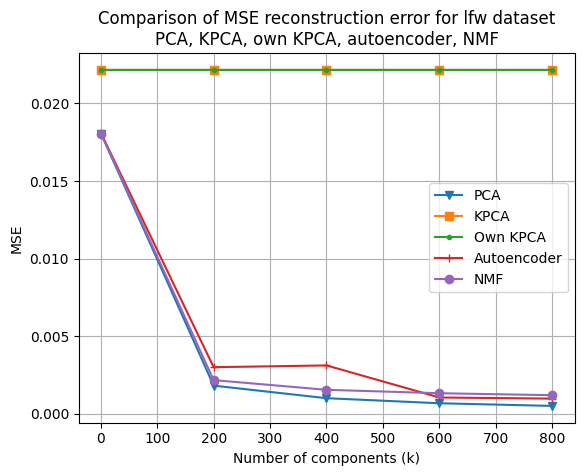

In [ ]:
# Reload the test data which was just saved
fn_prefix="results_"
fn=fn_prefix+dataset_name+".p"
print("Filename:",fn)
res_loaded={}
with open(fn,"rb") as fp:
    res_loaded = pickle.load(fp)

k_pca,loss_pca=res_query(res_loaded,model="pca")
k_spca,loss_spca=res_query(res_loaded,model="spca")
k_kpca,loss_kpca=res_query(res_loaded,model="kpca")
k_okpca,loss_okpca=res_query(res_loaded,model="own kpca")
k_autoencoder,loss_autoencoder=res_query(res_loaded,model="autoencoder")
k_nmf,loss_nmf=res_query(res_loaded,model="nmf")

# Plot comparison
plt.plot(k_pca,loss_pca,"v-")
#plt.plot(k_spca,loss_spca,"x-")
plt.plot(k_kpca,loss_kpca,"s-")
plt.plot(k_okpca,loss_okpca,".-")
plt.plot(k_autoencoder,loss_autoencoder,"+-")
plt.plot(k_nmf,loss_nmf,"o-")
plt.grid('on')
plt.xlabel('Number of components (k)')
plt.ylabel('MSE')
plt.title('Comparison of MSE reconstruction error for '+dataset_name+' dataset\nPCA, KPCA, own KPCA, autoencoder, NMF')
#plt.legend(["SPCA","KPCA","Autoencoder","NMF"])
plt.legend(["PCA", "KPCA", "Own KPCA", "Autoencoder", "NMF"])